In [8]:
from scipy import integrate, sparse
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

from numba import jit, njit

In [9]:
#initial conditions
dx = 0.01
x = np.arange(0, 10, dx)

kx = .1
m = 1
sigma = .1
x0 = 3
hbar = 1

A = 1/(sigma * np.sqrt(np.pi)) # normalization factor


Total Probability:  0.9999999999999998


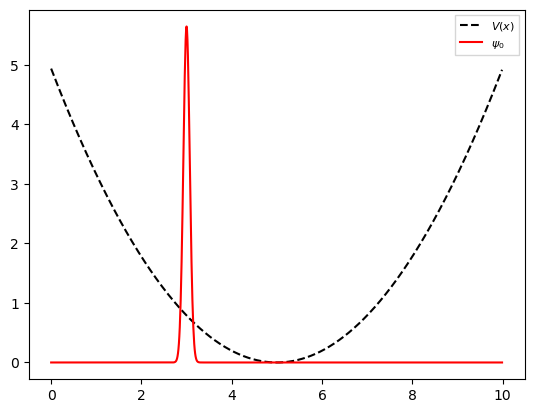

In [10]:
#initial wavefxn and potential
psi0 = np.sqrt(A) * np.exp(-((x-x0)**2)/(2*sigma**2))*np.exp(1j * kx * x)
psi02 = np.sqrt(A) * np.exp(-((x-x0)**2)/(2*sigma**2))*np.exp(1j * 500*kx * x)


x_Vmin = 5
T = 1 #period

omega = 2*np.pi/T
k = omega**2 * m
V = 0.5 * k * (x-x_Vmin)**2
V2 = np.piecewise(x, [x < 5, x >= 5], [0, 1000])
V3 = np.piecewise(x, [x < 5, x >= 5], [0, -1000])

plt.plot(x, V*0.01, "k--", label=r"$V(x)$")
plt.plot(x, np.abs(psi0)**2, "r", label=r"$\psi_0$")
plt.legend(loc=1, fontsize=8, fancybox=False)
print("Total Probability: ", np.sum(np.abs(psi0)**2)*dx)

In [11]:
#2nd deriv
D2 = sparse.diags([1, -2, 1], [-1, 0, 1], shape=(len(x), len(x))) / dx**2

In [12]:
#RHS of shro eqn
def psi_t(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + V*psi)

def psi_t2(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + V2*psi)

def psi_t3(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + V3*psi)

In [13]:
#time dependence
dt = .005
t0 = 0
tf = 1
t_eval = np.arange(t0, tf, dt)

#solve IVP
sol = integrate.solve_ivp(psi_t, t_span=(t0, tf), y0=psi0, t_eval = t_eval, method="RK23")
sol2 = integrate.solve_ivp(psi_t2, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="RK23")
sol3 = integrate.solve_ivp(psi_t3, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="RK23")

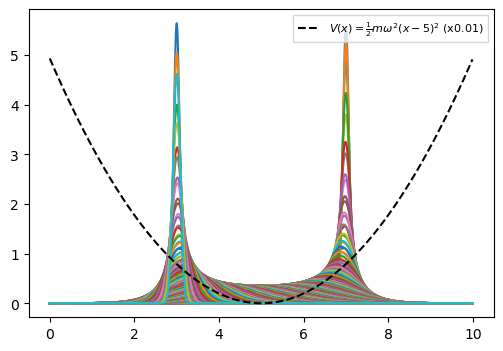

In [14]:
#Plot
fig = plt.figure(figsize=(6, 4))
for i, y in enumerate(sol.t):
    plt.plot(x, np.abs(sol.y[:, i])**2)
plt.plot(x, V * 0.01, "k--", label=r"$V(x) = \frac{1}{2}m\omega^2 (x-5)^2$ (x0.01)")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


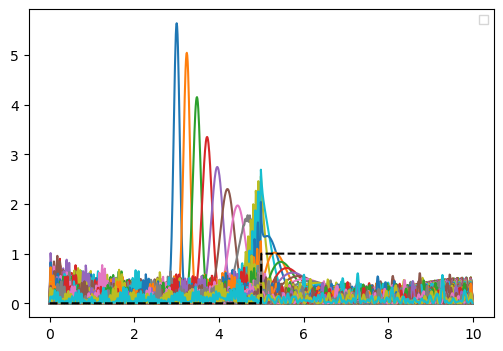

In [15]:
fig = plt.figure(figsize=(6, 4))
for i, y in enumerate(sol2.t):
    plt.plot(x, np.abs(sol2.y[:, i])**2)
plt.plot(x, V2*.001, "k--")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


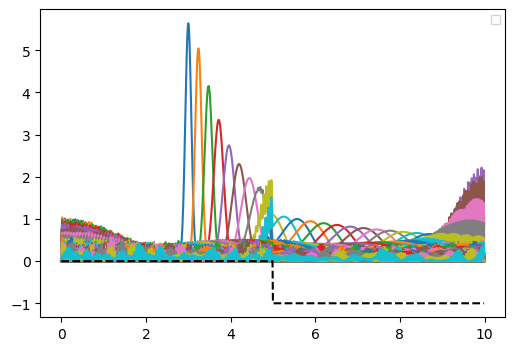

In [24]:
fig = plt.figure(figsize=(6, 4))
for i, y in enumerate(sol3.t):
    plt.plot(x, np.abs(sol3.y[:, i])**2)
plt.plot(x, V3*.001, "k--")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

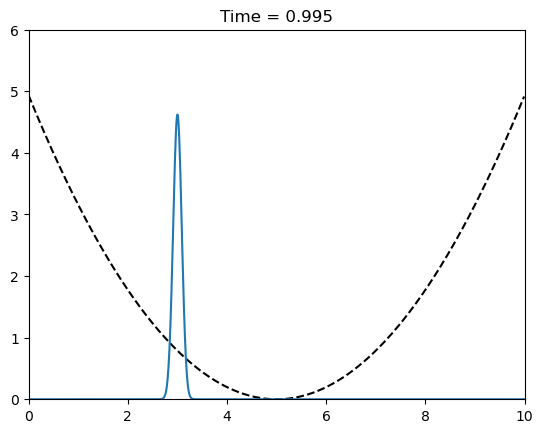

In [17]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(0, 6)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V*.01)
    return line1,

def animate(i):
    line2.set_data(x, np.abs(sol.y[:, i])**2)
    title.set_text("Time = {0:1.3f}".format(sol.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol.t), interval=50, blit=True)

HTML(anim.to_jshtml())

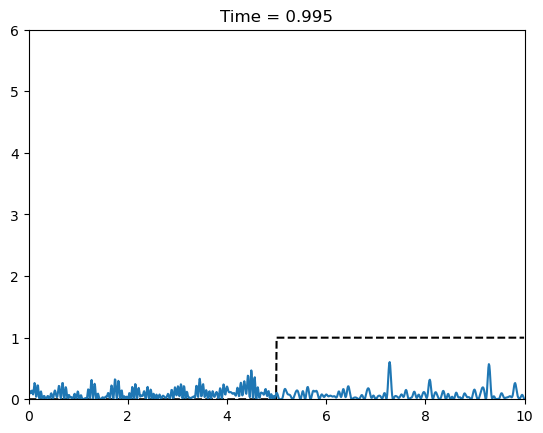

In [18]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(0, 6)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V2*.001)
    return line1,

def animate(i):
    line2.set_data(x, np.abs(sol2.y[:, i])**2)
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

HTML(anim.to_jshtml())

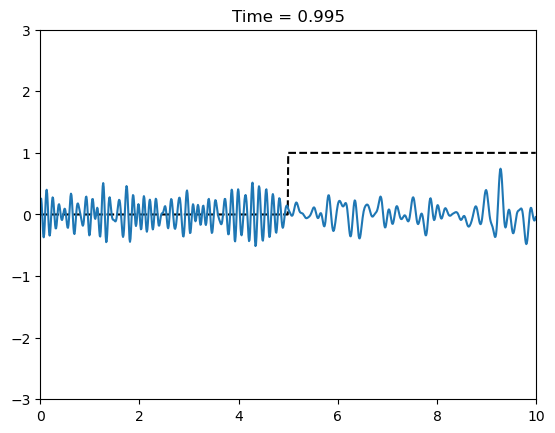

In [19]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(-3, 3)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V2*.001)
    return line1,

def animate(i):
    line2.set_data(x, np.real(sol2.y[:, i]))
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

HTML(anim.to_jshtml())

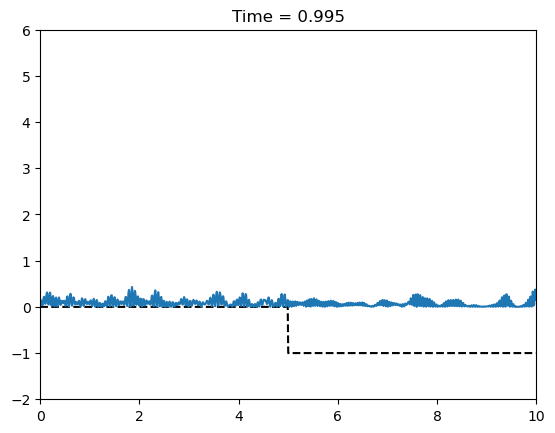

In [26]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(-2, 6)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V3*.001)
    return line1,

def animate(i):
    line2.set_data(x, np.abs(sol3.y[:, i])**2)
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol3.t), interval=50, blit=True)

HTML(anim.to_jshtml())

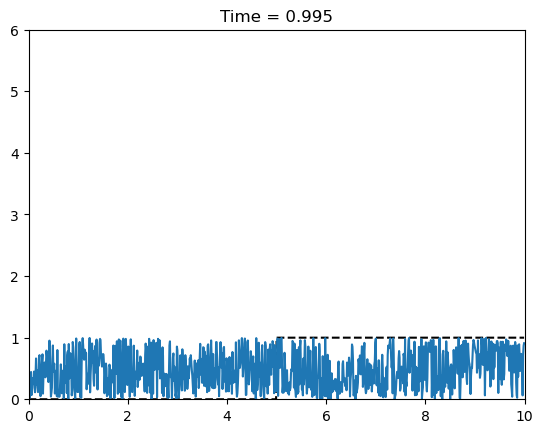

In [30]:
asy = np.abs((np.abs(sol2.y[:, i])**2 - np.abs(sol3.y[:, i])**2)/((np.abs(sol2.y[:, i])**2 + np.abs(sol3.y[:, i])**2)))
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, 10)
ax1.set_ylim(0, 6)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V2*.001)
    return line1,


def animate(i):
    line2.set_data(x, asy)
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

HTML(anim.to_jshtml())



C:\Users\natha\AppData\Local\Temp\ipykernel_7668\3144342460.py:2: RuntimeWarning: overflow encountered in true_divide
  diff = np.abs((sol2.y**2 - sol3.y**2) / (sol2.y**2 + sol3.y**2))
C:\Users\natha\AppData\Local\Temp\ipykernel_7668\3144342460.py:2: RuntimeWarning: invalid value encountered in true_divide
  diff = np.abs((sol2.y**2 - sol3.y**2) / (sol2.y**2 + sol3.y**2))


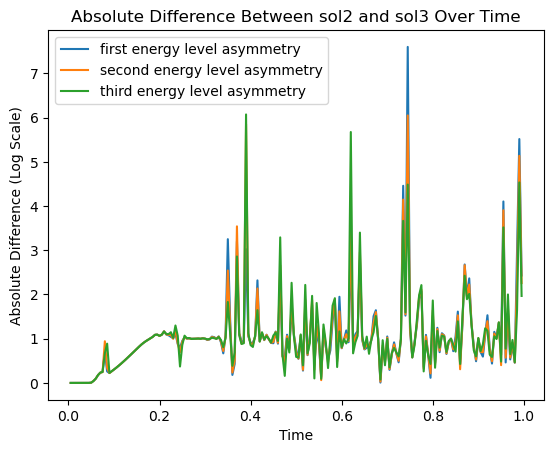

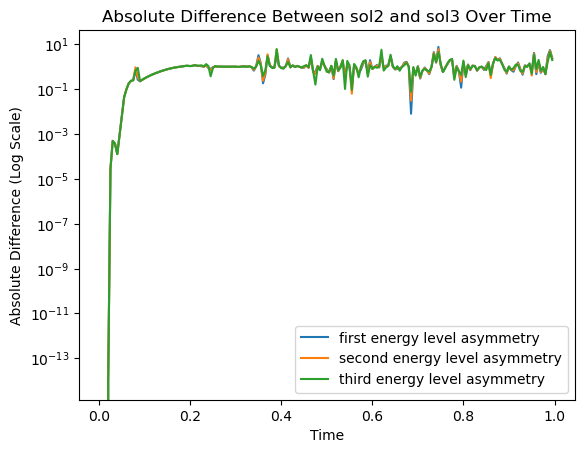

In [43]:
# Calculate the absolute value of the difference between sol2 and sol3
diff = np.abs((sol2.y**2 - sol3.y**2) / (sol2.y**2 + sol3.y**2))

# Plot the result
plt.figure()
plt.plot(t_eval, diff[0, :], label='first energy level asymmetry')
plt.plot(t_eval, diff[1, :], label='second energy level asymmetry')
plt.plot(t_eval, diff[2, :], label='third energy level asymmetry')
plt.xlabel('Time')
plt.ylabel('Absolute Difference (Log Scale)')
plt.title('Absolute Difference Between sol2 and sol3 Over Time')
plt.legend()
plt.show()

# Plot the result
plt.figure()
plt.semilogy(t_eval, diff[0, :], label='first energy level asymmetry')
plt.semilogy(t_eval, diff[1, :], label='second energy level asymmetry')
plt.semilogy(t_eval, diff[2, :], label='third energy level asymmetry')
plt.xlabel('Time')
plt.ylabel('Absolute Difference (Log Scale)')
plt.title('Absolute Difference Between sol2 and sol3 Over Time')
plt.legend()
plt.show()